In [149]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

# display all columns of the dataframe
pd.options.display.max_columns = None

# display all rows of the dataframe
pd.options.display.max_rows = None
 
# to display the float values upto 6 decimal places     
pd.options.display.float_format = '{:.6f}'.format

In [150]:
import re

In [136]:
from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google.colab'

About the Data:
Zomato is an Indian multinational restaurant aggregator and food delivery 
company founded by Deepinder Goyal and Pankaj Chaddah in 2008. Zomato 
provides information, menus, and user reviews of restaurants as well as food 
delivery options from partner restaurants in select cities

In [151]:
df=pd.read_csv('zomato.csv')

In [152]:
df.tail()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
51712,https://www.zomato.com/bangalore/best-brews-fo...,"Four Points by Sheraton Bengaluru, 43/3, White...",Best Brews - Four Points by Sheraton Bengaluru...,No,No,3.6 /5,27,080 40301477,Whitefield,Bar,NaN,Continental,"1,500","[('Rated 5.0', ""RATED\n Food and service are ...",[],Pubs and bars,Whitefield
51713,https://www.zomato.com/bangalore/vinod-bar-and...,"Number 10, Garudachar Palya, Mahadevapura, Whi...",Vinod Bar And Restaurant,No,No,NaN,0,+91 8197675843,Whitefield,Bar,NaN,Finger Food,600,[],[],Pubs and bars,Whitefield
51714,https://www.zomato.com/bangalore/plunge-sherat...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Plunge - Sheraton Grand Bengaluru Whitefield H...,No,No,NaN,0,NaN,Whitefield,Bar,NaN,Finger Food,"2,000",[],[],Pubs and bars,Whitefield
51715,https://www.zomato.com/bangalore/chime-sherato...,Sheraton Grand Bengaluru Whitefield Hotel & Co...,Chime - Sheraton Grand Bengaluru Whitefield Ho...,No,Yes,4.3 /5,236,080 49652769,"ITPL Main Road, Whitefield",Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500","[('Rated 4.0', 'RATED\n Nice and friendly pla...",[],Pubs and bars,Whitefield
51716,https://www.zomato.com/bangalore/the-nest-the-...,"ITPL Main Road, KIADB Export Promotion Industr...",The Nest - The Den Bengaluru,No,No,3.4 /5,13,+91 8071117272,"ITPL Main Road, Whitefield","Bar, Casual Dining",NaN,"Finger Food, North Indian, Continental","1,500","[('Rated 5.0', 'RATED\n Great ambience , look...",[],Pubs and bars,Whitefield


In [153]:
df.shape

(51717, 17)

In [154]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   url                          51717 non-null  object
 1   address                      51717 non-null  object
 2   name                         51717 non-null  object
 3   online_order                 51717 non-null  object
 4   book_table                   51717 non-null  object
 5   rate                         43942 non-null  object
 6   votes                        51717 non-null  int64 
 7   phone                        50509 non-null  object
 8   location                     51696 non-null  object
 9   rest_type                    51490 non-null  object
 10  dish_liked                   23639 non-null  object
 11  cuisines                     51672 non-null  object
 12  approx_cost(for two people)  51371 non-null  object
 13  reviews_list                 51

In [155]:
df.dtypes

url                            object
address                        object
name                           object
online_order                   object
book_table                     object
rate                           object
votes                           int64
phone                          object
location                       object
rest_type                      object
dish_liked                     object
cuisines                       object
approx_cost(for two people)    object
reviews_list                   object
menu_item                      object
listed_in(type)                object
listed_in(city)                object
dtype: object

1. URL - Website of the Zomato for each restaurant. - Object datatype
2. Address - Address of the Restaurant. - Object datatype
3. Name - Name of the restaurant. - Object datatype
4. Online Order - The customer ordered the menu online or not. - Object datatype
5. Book table - The customer has booked the table or not. - Object datatype
6. Rate - Rating of the restaurant that has by the customer. - Numerical datatype
7. Votes - The votes have been given by the customer to the restaurant. - Numerical
datatype
8. Phone - Contact number of the Restaurant. - Object datatype
9. Location - The city name where the restaurant is located. - Object datatype
10. Rest Type - The type of restaurant. - Object datatype
11. Dish liked - Dishes liked by the customer from the restaurant. - Object datatype
12. Cuisines - The cuisines that have been prepared by the restaurant. - Object datatype
13. Approx Cost for two people - The approximate cost of the customer for 2 people. -
Number datatype
14. Reviews list - The reviews made by the customers on the restaurant. - Object
datatype
15. Menu Item - The menu items that are usually available at the restaurant. - Object
datatype
16. Listed in (type) - Contains the type of the meal. - Object datatype
17. Listed in (city) - This contains the neighborhood in which the restaurant is listed. -
Object datatype

In [156]:
# percentage of NUll Values

round((df.isnull().sum()/df.shape[0])*100,2)

url                            0.000000
address                        0.000000
name                           0.000000
online_order                   0.000000
book_table                     0.000000
rate                          15.030000
votes                          0.000000
phone                          2.340000
location                       0.040000
rest_type                      0.440000
dish_liked                    54.290000
cuisines                       0.090000
approx_cost(for two people)    0.670000
reviews_list                   0.000000
menu_item                      0.000000
listed_in(type)                0.000000
listed_in(city)                0.000000
dtype: float64

In [157]:
# check Duplicated

df.duplicated().sum()

0

In [158]:
#check for Null Values

df.isnull().sum()


url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                            7775
votes                              0
phone                           1208
location                          21
rest_type                        227
dish_liked                     28078
cuisines                          45
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dtype: int64

In [159]:
# Information on Categorical features 
df.describe(include=['O'])


,url,address,name,online_order,book_table,rate,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
count,51717,51717,51717,51717,51717,43942,50509,51696,51490,23639,51672,51371,51717,51717,51717,51717
unique,51717,11495,8792,2,2,64,14926,93,93,5271,2723,70,22513,9098,7,30
top,https://www.zomato.com/bangalore/jalsa-banasha...,Delivery Only,Cafe Coffee Day,Yes,No,NEW,080 43334321,BTM,Quick Bites,Biryani,North Indian,300,[],[],Delivery,BTM
freq,1,128,96,30444,45268,2208,216,5124,19132,182,2913,7576,7595,39617,25942,3279


Droping few un-necessary columns like url, address, phone-number and location from dataset.

In [160]:
df.drop(columns=["url","address","phone","location"],axis=1,inplace=True)

Handling NUll Values

In [161]:
df.reviews_list = np.where(df.reviews_list == '[]',df.reviews_list.value_counts().index[1],df.reviews_list)
df.reviews_list.tail(3)

51714    [('Rated 5.0', "RATED\n  This lobby cafe offer...
51715    [('Rated 4.0', 'RATED\n  Nice and friendly pla...
51716    [('Rated 5.0', 'RATED\n  Great ambience , look...
Name: reviews_list, dtype: object

In [162]:
df['reviews_list'].isnull().sum()

0

In [163]:
def change_review_ratings(ele):
    sum_rating = 0
    x = re.findall('Rated.[0-9].[0-9]', ele)
    for i in x:
        sum_rating += float(i.split(" ")[1])
    return (sum_rating/len(x))

In [164]:
df["review_rating"] = df.reviews_list.map(change_review_ratings)
df.drop(["reviews_list"],axis=1,inplace=True)


In [165]:
df.tail()

,name,online_order,book_table,rate,votes,rest_type,dish_liked,cuisines,approx_cost(for two people),menu_item,listed_in(type),listed_in(city),review_rating
51712,Best Brews - Four Points by Sheraton Bengaluru...,No,No,3.6 /5,27,Bar,NaN,Continental,"1,500",[],Pubs and bars,Whitefield,4.125000
51713,Vinod Bar And Restaurant,No,No,NaN,0,Bar,NaN,Finger Food,600,[],Pubs and bars,Whitefield,5.000000
51714,Plunge - Sheraton Grand Bengaluru Whitefield H...,No,No,NaN,0,Bar,NaN,Finger Food,"2,000",[],Pubs and bars,Whitefield,5.000000
51715,Chime - Sheraton Grand Bengaluru Whitefield Ho...,No,Yes,4.3 /5,236,Bar,"Cocktails, Pizza, Buttermilk",Finger Food,"2,500",[],Pubs and bars,Whitefield,4.000000
51716,The Nest - The Den Bengaluru,No,No,3.4 /5,13,"Bar, Casual Dining",NaN,"Finger Food, North Indian, Continental","1,500",[],Pubs and bars,Whitefield,5.000000


In [166]:
df["dish_liked"] = df["dish_liked"].fillna(df.dish_liked.mode()[0])
df["cuisines"].fillna(df.cuisines.mode()[0],inplace=True)
df["rest_type"].fillna(df.rest_type.mode()[0],inplace=True)


In [167]:
df["approx_cost(for two people)"] = df["approx_cost(for two people)"].str.replace(',',"")
df["approx_cost(for two people)"] = df["approx_cost(for two people)"].apply(pd.to_numeric)
df["approx_cost(for two people)"].fillna(df["approx_cost(for two people)"].mean(),inplace=True)

In [168]:
df.rate.mask(df.rate=="NEW", df.rate.value_counts().index[1],inplace=True)
df.rate.fillna(df.rate.mode()[0],inplace=True)
df.rate = df.rate.apply(lambda x:x.split('/')[0])
no_rating = list(df[df["rate"]=='-'].index)
df.rate.drop(index=no_rating,axis=0,inplace=True)

In [169]:
top_15_cuisines = list(df.cuisines.value_counts()[:15].index)
df["cuisines_variety"] = df["cuisines"].apply(lambda x:len(x.replace(" ","").split(",")))

In [170]:
top_15_cuisines

['North Indian',
 'North Indian, Chinese',
 'South Indian',
 'Biryani',
 'Bakery, Desserts',
 'Fast Food',
 'Desserts',
 'Cafe',
 'South Indian, North Indian, Chinese',
 'Bakery',
 'Chinese',
 'Ice Cream, Desserts',
 'Chinese, North Indian',
 'Mithai, Street Food',
 'Desserts, Ice Cream']

In [ ]:
df2 = df.loc[df.dish_liked.isin(["Friendly Staff","Decor","Prompt Services"])].index
for i in df2:
    df.loc[i,"dish_liked"] = df.dish_liked.mode()[0]

In [171]:
top_20_fav_df = pd.DataFrame({"Dish":list(df.dish_liked.value_counts()[:20].index),"count":list(df.dish_liked.value_counts()[:20].values)})  

In [172]:
top_20_fav_df

,Dish,count
0,Biryani,28260
1,Chicken Biryani,73
2,Friendly Staff,69
3,Waffles,68
4,Paratha,57
5,Masala Dosa,56
6,Rooftop Ambience,42
7,Coffee,42
8,Pizza,38
9,Burgers,33


In [173]:
def change_dishes(ele):
    if ele in top_20_fav_df["Dish"].values:
        return "most_fav_dishes"
    else:
        return "least_fav_dishes"


In [174]:
df.dish_liked = df.dish_liked.map(change_dishes)
df.menu_item = np.where(df.menu_item == '[]',df.menu_item.value_counts().index[1],df.menu_item)

In [175]:
df["no_of_items"] = df["menu_item"].apply(lambda x:len(x))
df.rename(columns={"listed_in(city)": "location", "listed_in(type)": "is_buffet","no_of_items":"item_served_count"},inplace=True)
df.drop(["name","menu_item","cuisines"],axis=1,inplace=True) 

In [176]:
df.tail()

,online_order,book_table,rate,votes,rest_type,dish_liked,approx_cost(for two people),is_buffet,location,review_rating,cuisines_variety,item_served_count
51712,No,No,3.6,27,Bar,most_fav_dishes,1500.000000,Pubs and bars,Whitefield,4.125000,1,2116
51713,No,No,3.9,0,Bar,most_fav_dishes,600.000000,Pubs and bars,Whitefield,5.000000,1,2116
51714,No,No,3.9,0,Bar,most_fav_dishes,2000.000000,Pubs and bars,Whitefield,5.000000,1,2116
51715,No,Yes,4.3,236,Bar,least_fav_dishes,2500.000000,Pubs and bars,Whitefield,4.000000,1,2116
51716,No,No,3.4,13,"Bar, Casual Dining",most_fav_dishes,1500.000000,Pubs and bars,Whitefield,5.000000,3,2116


In [177]:
df.rename(columns = {'approx_cost(for two people)':'approx_cost'}, inplace = True) #'approx_cost' would be easily accessable.

In [178]:
df.isnull().sum()

online_order         0
book_table           0
rate                 0
votes                0
rest_type            0
dish_liked           0
approx_cost          0
is_buffet            0
location             0
review_rating        0
cuisines_variety     0
item_served_count    0
dtype: int64

In [179]:
df.describe()

,votes,approx_cost,review_rating,cuisines_variety,item_served_count
count,51717.000000,51717.000000,51717.000000,51717.000000,51717.000000
mean,283.697527,555.431566,3.827961,2.453043,2192.668001
std,803.838853,437.380224,0.956809,1.270445,925.660627
min,0.000000,40.000000,1.000000,1.000000,8.000000
25%,7.000000,300.000000,3.254286,2.000000,2116.000000
50%,41.000000,400.000000,4.000000,2.000000,2116.000000
75%,198.000000,650.000000,4.565217,3.000000,2116.000000
max,16832.000000,6000.000000,5.000000,8.000000,24897.000000


<AxesSubplot:>

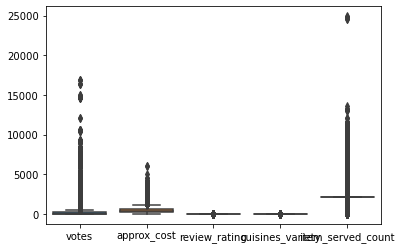

In [180]:
sns.boxplot(data=df)

In [186]:
df['rate'].head()

0    4.1
1    4.1
2    3.8
3    3.7
4    3.8
Name: rate, dtype: object

import re #regex!

#### Define a function to clean the age column
def clean_age(age):
    age = str(age) # Convert to string
    age = re.sub('[^0-9\-]', '', age) # Remove any non-numeric characters
    age = age.split('-') # Split the string into a list of values
    age = [int(x) for x in age if x != ''] # Convert each value to an integer and remove any empty strings
    if len(age) == 1:
        return age[0]/100
    else:
        return age/100 # Return the average of the lower and upper bounds of the age group

#### Apply the clean_age function to the age column
df['rate'] = df['rate'].apply(clean_age)

#df['rating']=df['rate'].apply(pd.to_numeric)
df['rating']=df['rate'].astype(float)

In [187]:
q3=df.quantile(0.75)
q1=df.quantile(0.25)
IQR=q3-q1
df_limits=df[~((df < (q1-1.5*IQR)) | (df> (q3+1.5*IQR))).any(axis=1)]
df_limits

,online_order,book_table,rate,votes,rest_type,dish_liked,approx_cost,is_buffet,location,review_rating,cuisines_variety,item_served_count
3,No,No,3.7,88,Quick Bites,most_fav_dishes,300.000000,Buffet,Banashankari,3.671429,2,2116
4,No,No,3.8,166,Casual Dining,least_fav_dishes,600.000000,Buffet,Banashankari,4.000000,2,2116
5,Yes,No,3.8,286,Casual Dining,least_fav_dishes,600.000000,Buffet,Banashankari,3.000000,1,2116
6,No,No,3.6,8,Casual Dining,most_fav_dishes,800.000000,Buffet,Banashankari,5.000000,4,2116
8,Yes,No,4.0,324,Cafe,least_fav_dishes,700.000000,Cafes,Banashankari,3.303797,3,2116
10,Yes,No,4.1,402,Cafe,least_fav_dishes,500.000000,Cafes,Banashankari,3.857143,1,2116
11,Yes,Yes,4.2,150,Cafe,least_fav_dishes,600.000000,Cafes,Banashankari,4.000000,3,2116
12,Yes,Yes,4.2,164,Cafe,least_fav_dishes,500.000000,Cafes,Banashankari,3.846154,4,2116
13,No,No,4.0,424,Cafe,least_fav_dishes,450.000000,Cafes,Banashankari,3.208333,2,2116
15,Yes,No,3.8,90,Cafe,least_fav_dishes,650.000000,Cafes,Banashankari,3.666667,1,2116


In [147]:
lower_limit=q1-1.5*IQR
upper_limit=q3+1.5*IQR

df.drop(['rate'],axis=1,inplace= True)

In [188]:
df_limits.shape

(30473, 12)

In [189]:
df_copy= df_limits.copy()

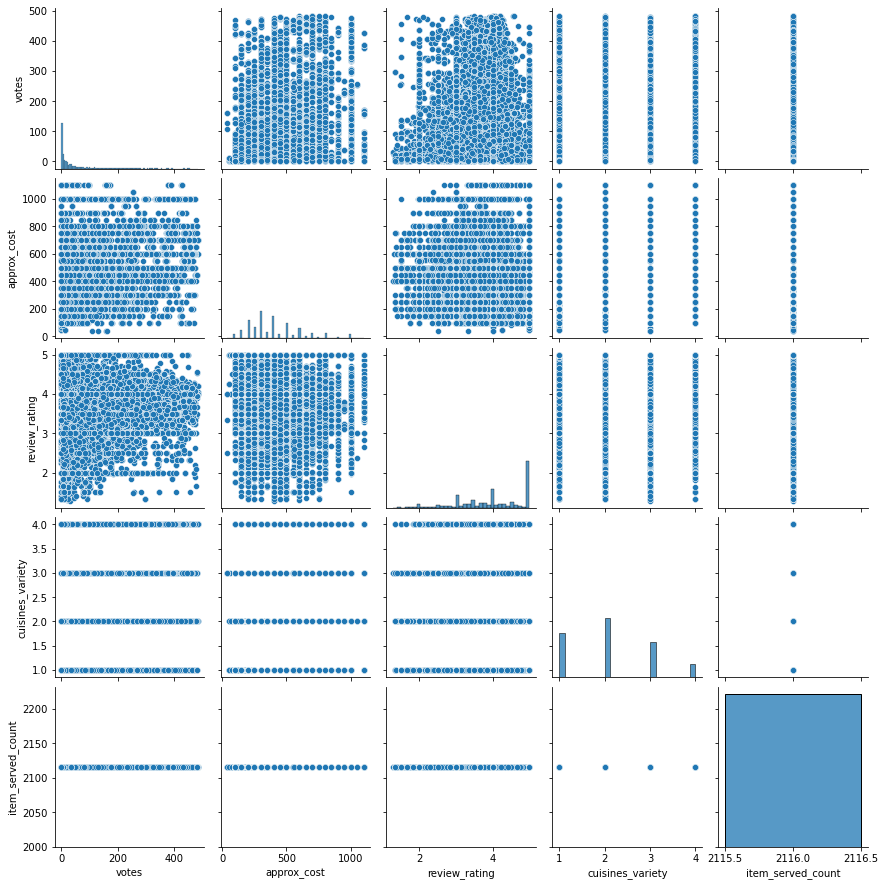

In [190]:
sns.pairplot(df_copy)

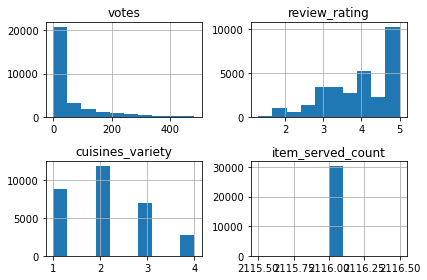

Skewness:


votes                2.215218
review_rating       -0.503480
cuisines_variety     0.430574
item_served_count    0.000000
dtype: float64

In [191]:
df_copy.drop('approx_cost', axis = 1).hist()
plt.tight_layout()
plt.show()  
print('Skewness:')
df_copy.drop('approx_cost', axis = 1).skew()

In [192]:
df_copy.head()

,online_order,book_table,rate,votes,rest_type,dish_liked,approx_cost,is_buffet,location,review_rating,cuisines_variety,item_served_count
3,No,No,3.7,88,Quick Bites,most_fav_dishes,300.000000,Buffet,Banashankari,3.671429,2,2116
4,No,No,3.8,166,Casual Dining,least_fav_dishes,600.000000,Buffet,Banashankari,4.000000,2,2116
5,Yes,No,3.8,286,Casual Dining,least_fav_dishes,600.000000,Buffet,Banashankari,3.000000,1,2116
6,No,No,3.6,8,Casual Dining,most_fav_dishes,800.000000,Buffet,Banashankari,5.000000,4,2116
8,Yes,No,4.0,324,Cafe,least_fav_dishes,700.000000,Cafes,Banashankari,3.303797,3,2116


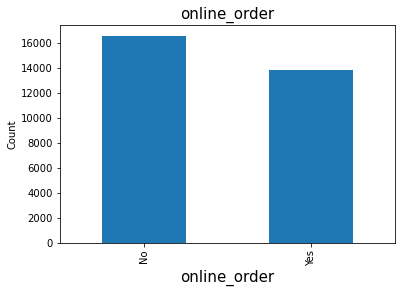

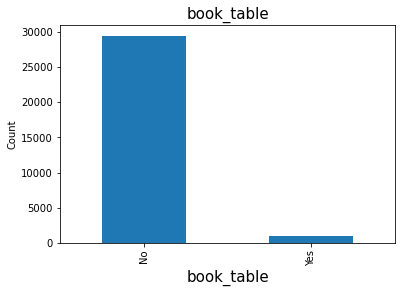

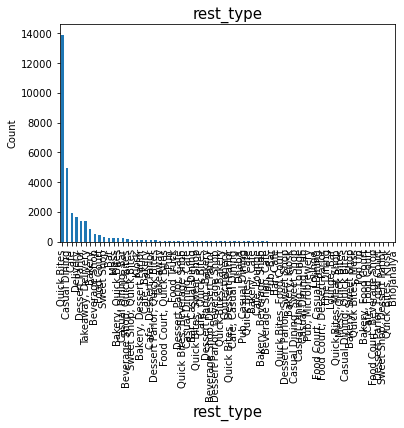

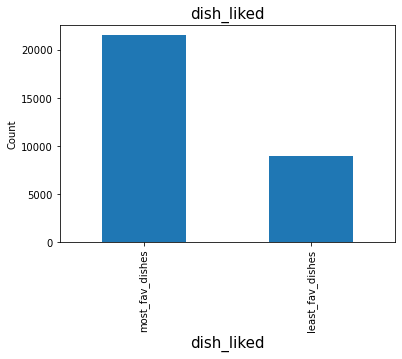

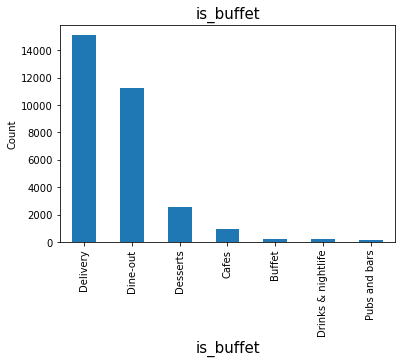

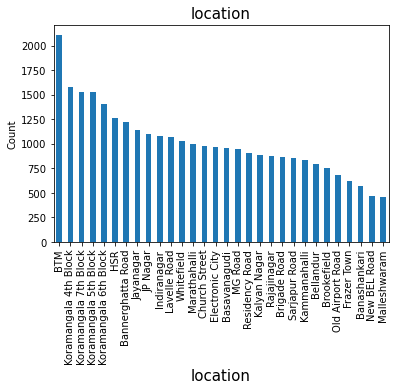

In [193]:
# Assuming 'df' is the DataFrame you want to use
variables_to_plot = ['online_order','book_table','rest_type','dish_liked','is_buffet','location']
#for variable in variables_to_plot:
    #sns.countplot(x=variable, data=df)
for variable in variables_to_plot:
    plt.figure()
    df_copy[variable].value_counts().plot(kind='bar')
    plt.title(variable,fontsize = 15)
    plt.xlabel(variable,fontsize = 15)
    plt.ylabel('Count')
    plt.show()


In [195]:
from sklearn.preprocessing import MinMaxScaler
# store the target variable 'Chance of Admit' in a dataframe 'df_target'
df_target = df_copy['approx_cost']

# store all the independent variables in a dataframe 'df_feature' 
# drop the column 'Chance of Admit' using drop()
# 'axis = 1' drops the specified column
df_feature = df_copy.drop('approx_cost', axis = 1)

In [196]:
# filter the numerical features in the dataset
# 'select_dtypes' is used to select the variables with given data type
# 'include = [np.number]' will include all the numerical variables
df_num = df_feature.select_dtypes(include = [np.number])

# display numerical features
df_num.columns

Index(['votes', 'review_rating', 'cuisines_variety', 'item_served_count'], dtype='object')

In [197]:
# filter the categorical features in the dataset
# 'select_dtypes' is used to select the variables with given data type
# 'include = [np.object]' will include all the categorical variables
df_cat = df_feature.select_dtypes(include = [np.object])

# display categorical features
df_cat.columns

Index(['online_order', 'book_table', 'rate', 'rest_type', 'dish_liked',
       'is_buffet', 'location'],
      dtype='object')

In [198]:
# use 'get_dummies' from pandas to create dummy variables
# use 'drop_first' to create (n-1) dummy variables
dummy_var = pd.get_dummies(data = df_cat, drop_first = True)

In [199]:
# initialize the standard scalar
X_scaler = StandardScaler()

# scale all the numerical columns
# standardize all the columns of the dataframe 'df_num'
num_scaled = X_scaler.fit_transform(df_num)

# create a dataframe of scaled numerical variables
# pass the required column names to the parameter 'columns'
df_num_scaled = pd.DataFrame(num_scaled, columns = df_num.columns)

In [200]:
# concat the dummy variables with numeric features to create a dataframe of all independent variables
# 'axis=1' concats the dataframes along columns 
X = pd.concat([df_num_scaled, dummy_var], axis = 1)

# display first five observations
X.head()

,votes,review_rating,cuisines_variety,item_served_count,online_order_Yes,book_table_Yes,rate_2.0,rate_2.1,rate_2.1,rate_2.2,rate_2.2,rate_2.3,rate_2.3,rate_2.4,rate_2.4,rate_2.5,rate_2.5,rate_2.6,rate_2.6,rate_2.7,rate_2.7,rate_2.8,rate_2.8,rate_2.9,rate_2.9,rate_3.0,rate_3.0,rate_3.1,rate_3.1,rate_3.2,rate_3.2,rate_3.3,rate_3.3,rate_3.4,rate_3.4,rate_3.5,rate_3.5,rate_3.6,rate_3.6,rate_3.7,rate_3.7,rate_3.8,rate_3.8,rate_3.9,rate_3.9,rate_4.0,rate_4.0,rate_4.1,rate_4.1,rate_4.2,rate_4.2,rate_4.3,rate_4.3,rate_4.4,rate_4.4,rate_4.5,rate_4.5,rate_4.6,rate_4.6,rate_4.7,rate_4.8,rate_4.8,rate_4.9,"rest_type_Bakery, Beverage Shop","rest_type_Bakery, Cafe","rest_type_Bakery, Dessert Parlor","rest_type_Bakery, Food Court","rest_type_Bakery, Kiosk","rest_type_Bakery, Quick Bites","rest_type_Bakery, Sweet Shop",rest_type_Bar,"rest_type_Bar, Cafe","rest_type_Bar, Casual Dining",rest_type_Beverage Shop,"rest_type_Beverage Shop, Cafe","rest_type_Beverage Shop, Dessert Parlor","rest_type_Beverage Shop, Quick Bites",rest_type_Bhojanalya,rest_type_Cafe,"rest_type_Cafe, Bakery","rest_type_Cafe, Casual Dining","rest_type_Cafe, Dessert Parlor","rest_type_Cafe, Food Court","rest_type_Cafe, Lounge","rest_type_Cafe, Quick Bites",rest_type_Casual Dining,"rest_type_Casual Dining, Bar","rest_type_Casual Dining, Cafe","rest_type_Casual Dining, Lounge","rest_type_Casual Dining, Pub","rest_type_Casual Dining, Quick Bites","rest_type_Casual Dining, Sweet Shop",rest_type_Confectionery,rest_type_Delivery,rest_type_Dessert Parlor,"rest_type_Dessert Parlor, Bakery","rest_type_Dessert Parlor, Beverage Shop","rest_type_Dessert Parlor, Cafe","rest_type_Dessert Parlor, Food Court","rest_type_Dessert Parlor, Quick Bites","rest_type_Dessert Parlor, Sweet Shop",rest_type_Dhaba,rest_type_Fine Dining,rest_type_Food Court,"rest_type_Food Court, Beverage Shop","rest_type_Food Court, Casual Dining","rest_type_Food Court, Dessert Parlor","rest_type_Food Court, Quick Bites",rest_type_Food Truck,rest_type_Kiosk,rest_type_Lounge,"rest_type_Lounge, Bar",rest_type_Mess,"rest_type_Mess, Quick Bites",rest_type_Pop Up,rest_type_Pub,"rest_type_Pub, Bar","rest_type_Pub, Casual Dining","rest_type_Pub, Microbrewery",rest_type_Quick Bites,"rest_type_Quick Bites, Bakery","rest_type_Quick Bites, Beverage Shop","rest_type_Quick Bites, Cafe","rest_type_Quick Bites, Dessert Parlor","rest_type_Quick Bites, Food Court","rest_type_Quick Bites, Kiosk","rest_type_Quick Bites, Meat Shop","rest_type_Quick Bites, Mess","rest_type_Quick Bites, Sweet Shop",rest_type_Sweet Shop,"rest_type_Sweet Shop, Dessert Parlor","rest_type_Sweet Shop, Quick Bites",rest_type_Takeaway,"rest_type_Takeaway, Delivery",dish_liked_most_fav_dishes,is_buffet_Cafes,is_buffet_Delivery,is_buffet_Desserts,is_buffet_Dine-out,is_buffet_Drinks & nightlife,is_buffet_Pubs and bars,location_Banashankari,location_Bannerghatta Road,location_Basavanagudi,location_Bellandur,location_Brigade Road,location_Brookefield,location_Church Street,location_Electronic City,location_Frazer Town,location_HSR,location_Indiranagar,location_JP Nagar,location_Jayanagar,location_Kalyan Nagar,location_Kammanahalli,location_Koramangala 4th Block,location_Koramangala 5th Block,location_Koramangala 6th Block,location_Koramangala 7th Block,location_Lavelle Road,location_MG Road,location_Malleshwaram,location_Marathahalli,location_New BEL Road,location_Old Airport Road,location_Rajajinagar,location_Residency Road,location_Sarjapur Road,location_Whitefield
0,0.276847,-0.341618,-0.129373,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [202]:
X.shape

(42877, 170)